# Michel Electron Selection and Reconstruction

Michel electrons come out of a muon decay. They are electrons, so they look like a lower energy electromagnetic shower attached to the end of a stopping muon track.


## I. Motivation

Michel electrons are used in LArTPC experiments as “standard candles”: we understand their energy spectrum very well, so they can be used to calibrate the detector and to compare the quality of different detectors. The Michel electron spectrum is one of the first “tokens” that an experiment will show to prove that the detector is running and we can successfully reconstruct the data. Since their energy is in a range up to ~50MeV, they are also representative of the detector response to electromagnetic particles generated by low energy neutrino activity.

<figure>
<img src="./Michel_spec.png" style="width:50%">
<figcaption align = "center"> Example of Michel electron spectrum </figcaption>
</figure>

### What are we looking at?

Ionization produces track-like energy depositions, whereas the photons can travel some distance before converting into a secondary electron. Hence Michel electrons have two clear topological features: a primary ionization, which is track-like at the end of the muon track, and some scattered energy deposits much further away which come from these radiative photons.

<figure>
<img src="./michel.png" style="width:50%">
<figcaption align = "center"> Example of Michel electron topology </figcaption>
</figure>

The primary Michel electron that comes out of the muon decay-at-rest can lose energy either through ionization (collision stopping power), or through the production of radiative photons via Bremsstrahlung (radiative stopping power). Beyond a certain energy, the radiative stopping power is greater than the collision stopping power. If the radiative photons have enough energy, they can pair-produce, i.e. turn into an electron-positron pair. They, in turn, can produce new radiative photons, and so on. They can also undergo Compton scattering. A cascade of electrons and photons (electromagnetic shower) happens.

<figure>
<img src="./electron_stopping_power.png" style="width:50%">
<figcaption align = "center"> Energy loss per unit distance (MeV/cm) for electrons traveling in liquid argon </figcaption>
</figure>


## II. Setup

We first need to set the working environment and the path to the dataset.

In [8]:
import sys

SOFTWARE_DIR = '/sdf/home/j/junjie/sdf-data/Michel/spine' # Change this path to your software install
DATA_DIR = '../data' # Change this path if you are not on SDF
# data path on icarusgpvm: /exp/icarus/app/users/jxia/shared/michel

# Set software directory
sys.path.append(SOFTWARE_DIR)

Also, let's import some libraries

In [75]:
import numpy as np
import math
import pandas as pd
from collections import OrderedDict

from scipy.spatial.distance import cdist

Now pass the analysis configuration

In [76]:
import yaml
import os

filelist = os.path.join(DATA_DIR,'filelist_short.txt')

cfg = '''
# Load HDF5 files
io:
  reader:
    name: hdf5
    file_keys: DATA_PATH
    
# Build reconstruction output representations
build:
  mode: both
  units: cm
  fragments: true
  particles: true
  interactions: true
'''.replace('DATA_PATH', filelist)

cfg = yaml.safe_load(cfg)

#with open(filelist) as f:
#    DATA_PATH = [line.strip() for line in f if line.strip()]
#print(DATA_PATH)

Now initialize the driver with this configuration

In [77]:
from spine.driver import Driver

driver = Driver(cfg)


 ██████████   ██████████    ███   ███       ██   ███████████
███        █  ██       ███   █    █████     ██   ██         
  ████████    ██       ███  ███   ██  ████  ██   ██████████ 
█        ███  ██████████     █    ██     █████   ██         
 ██████████   ██            ███   ██       ███   ███████████

Release version: 0.6.1

$CUDA_VISIBLE_DEVICES=0

Configuration processed at: Linux sdfampere015 4.18.0-372.32.1.el8_6.x86_64 #1 SMP Fri Oct 7 12:35:10 EDT 2022 x86_64 x86_64 x86_64 GNU/Linux

base: {world_size: 0, seed: 1759288382}
io:
  reader: {name: hdf5, file_keys: ../data/filelist_short.txt}
build: {mode: both, units: cm, fragments: true, particles: true, interactions: true}

Will load 5 file(s):
 - /sdf/home/j/junjie/sdf-data/Michel/production/scripts/output_spine/larcv_mc_20250209_225653_302710-715afee4-87bf-4fd2-9df7-99acc839d6b9_spine.h5
 - /sdf/home/j/junjie/sdf-data/Michel/production/scripts/output_spine/larcv_mc_20250209_233341_948347-d68f395e-7c7b-4baf-a6fa-4a2b97de3034_s

Let's get the first entry

In [78]:
ENTRY = 0
data = driver.process(entry=ENTRY)

Let's get reconstructed/truth particles

In [79]:
reco_particles     = data['reco_particles']
truth_particles    = data['truth_particles']

Let's import michel shape and track shape from spine.utils.globals

In [80]:
from spine.utils.globals import SHAPE_LABELS, MICHL_SHP, TRACK_SHP

In [81]:
print(SHAPE_LABELS)

{-1: 'Unknown', 0: 'Shower', 1: 'Track', 2: 'Michel', 3: 'Delta', 4: 'LE', 5: 'Ghost', 6: 'Unknown'}


In [82]:
print(MICHL_SHP, TRACK_SHP)

2 1


Let's see if this entry has Michels

In [83]:
print('Number of reconstructed Michel:', np.sum(np.array([p.shape for p in reco_particles]) == MICHL_SHP))
print('Number of true Michel:', np.sum(np.array([p.shape for p in truth_particles]) == MICHL_SHP))

Number of reconstructed Michel: 1
Number of true Michel: 2


## III. Selecting Michel Electrons

Let's draw Michels in this entry.

In [84]:
from spine.vis.out import Drawer
drawer = Drawer(data, detector='icarus', truth_point_mode='points') # Try to replace none with 'icarus', 'sbnd' or '2x2'!

# With 'shape' option, the color indicdates particle shape
fig = drawer.get('particles', 'shape', draw_end_points=False, draw_vertices=False) 
#fig.show()

### Selecting Michel candidates
**Criteria 1: closeness of Michel and track end point**
To check if our candidate michel is actually adjacent to a track, we will set a minimum distance threshold (`attach_threshold`) between the Michel electron and the nearesttrack within the same interaction.


In [85]:
# Selection parameters
muon_min_voxel_count=30
attach_threshold = 3
match_threshold = 0.5

In [86]:
from sklearn.cluster import DBSCAN

def is_attached_at_edge(points1, points2, attached_threshold=3,
                        one_pixel=6, ablation_radius=4.5, ablation_min_samples=5):
    """
    Check if Michel is attached at the edge of a track.

    Args:
        points1: Michel points
        points2: Track points
        attached_threshold: Distance threshold for attachment (cm)
        one_pixel: DBSCAN eps parameter (cm)
        ablation_radius: Radius for ablation (cm)
        ablation_min_samples: Minimum samples for DBSCAN
        return_dbscan_cluster_count: Whether to return cluster counts

    Returns:
        bool: True if attached at edge, False otherwise
        float: Minimum distance between a michel and muon
    """
    distances = cdist(points1, points2)
    min_dist = np.min(distances)
    Michel_min, MIP_min = np.unravel_index(np.argmin(distances), distances.shape)
    min_coords = points2[MIP_min, :]

    is_attached = min_dist < attached_threshold
    if not is_attached:
        return is_attached, min_dist
        
    ablated_cluster = points2[np.linalg.norm(points2 - min_coords, axis=1) > ablation_radius]

    if ablated_cluster.shape[0] > 0:
        dbscan = DBSCAN(eps=one_pixel, min_samples=ablation_min_samples)
        old_cluster = dbscan.fit(points2).labels_
        new_cluster = dbscan.fit(ablated_cluster).labels_
        # If only one cluster is left, we were at the edge
        # Account for old cluster count in case track is fragmented
        # and put together by Track GNN
        old_cluster_count = len(np.unique(old_cluster[old_cluster > -1]))
        new_cluster_count = len(np.unique(new_cluster[new_cluster > -1]))
        is_edge = (old_cluster_count - new_cluster_count) <= 1 and old_cluster_count >= new_cluster_count
    else:
        # if nothing is left after ablating, this is a really small muon... calling it the edge
        is_edge = True

    return is_attached and is_edge, min_dist

### Finding true Michels

Let's find true Michels first. 
In SPINE the truth information has 3 attributes: "points_g4", "points", and "points_adapt" available:
- "points_g4" is the Geant 4 ground truth for energy deposition space points
- "points" is the training target for SPINE and is not the same as "points_g4" due to differences between the true energy deposition space points and what we "see" in LArTPC
- "points_adapt" is the true labeling adapted to the reconstructed space points.

For this tutorial we will use `points`

In [87]:
def fill_true_michels(it, truth_particles, true_michels, attr=None):
    
    # it: entry number, iteration
    # truth_particles: truth_particles
    # true_michels: output list of ordered dictionary of true michels
    # attr: which true point attribute to use, e.g. 'points', 'points_adapt', 'points_g4'

    points_att = "points"
    index_att = "index"
    size_att = "size"
    edep_att = "depositions"

    track_id_used = []
    
    if attr is not None:
        if "adapt" in attr.lower():
            points_att = "points_adapt"
            index_att = "index_adapt"
            size_att = "size_adapt"
            edep_att = "depositions_adapt"
        elif "g4" in attr.lower():
            points_att = "points_g4"
            index_att = "index_g4"
            size_att = "size_g4"
            edep_att = "depositions_g4"
        
    for tp in truth_particles:                
        if tp.shape != MICHL_SHP: continue

        michel_points_to_use = getattr(tp, points_att)
        if len(michel_points_to_use) == 0: continue
        is_contained = tp.is_contained                                                                                           
        int_id = tp.interaction_id
        is_attached = False

        michel_index = getattr(tp, index_att)
        michel_edep = getattr(tp, edep_att)
        michel_size = getattr(tp, size_att) 
        
        d_min = math.inf
        id_min = -1
        for tp2 in truth_particles:
            if tp2.id in track_id_used:
                continue
            if tp2.interaction_id != int_id: continue
            if tp2.shape != TRACK_SHP: continue
                
            muon_points_to_use = getattr(tp2, points_att)
            muon_size = getattr(tp2, size_att)
            if muon_size < muon_min_voxel_count: continue

            is_attached, d = is_attached_at_edge(michel_points_to_use, muon_points_to_use, 
                                                 attached_threshold=attach_threshold, 
                                                 one_pixel=6, ablation_radius=4.5, ablation_min_samples=5)

            if is_attached:
                d_min = d
                id_min = tp2.id

        if id_min > -1 and id_min not in track_id_used:
            track_id_used.append(id_min)

        new_dict = OrderedDict({
                    'index': it,
                    'id': int(tp.id),
                    'attach_dist': float(d_min),
                    'is_attached': is_attached,
                    'is_contained': is_contained,
                    'is_matched': tp.is_matched,
                    'match_ids': tp.match_ids,
                    'match_overlaps': tp.match_overlaps,
                    'total_pix': michel_size,
                    'total_deposition': float(np.sum(michel_edep)),
                    'ke': float(tp.ke)})
                
        true_michels.append(new_dict)

In [88]:
true_michels = []
fill_true_michels(ENTRY, truth_particles, true_michels)

In [89]:
true_michels

[OrderedDict([('index', 0),
              ('id', 57),
              ('attach_dist', 0.5999908447265625),
              ('is_attached', True),
              ('is_contained', True),
              ('is_matched', True),
              ('match_ids', array([25, 23])),
              ('match_overlaps',
               array([0.71153843, 0.22      ], dtype=float32)),
              ('total_pix', 49),
              ('total_deposition', 17.554288864135742),
              ('ke', 23.01705216427673)]),
 OrderedDict([('index', 0),
              ('id', 71),
              ('attach_dist', 0.29998779296875),
              ('is_attached', True),
              ('is_contained', False),
              ('is_matched', True),
              ('match_ids', array([38])),
              ('match_overlaps', array([0.00281558], dtype=float32)),
              ('total_pix', 19),
              ('total_deposition', 3.419330596923828),
              ('ke', 28.16519865572318)])]

### Finding the primary Michel

The Michel at the fragment and particle levels are different:
- In `fragments` a Michel is only the primary michel
- In `particles` a primary Michel is combined with the radiation part when appropriate

In [90]:
def fill_true_michels_and_primary(it, truth_particles, true_michels, attr=None):
    
    # it: entry number, iteration
    # truth_particles: truth_particles
    # true_michels: output list of ordered dictionary of true michels
    # attr: which true point attribute to use, e.g. 'points', 'points_adapt', 'points_g4'

    points_att = "points"
    index_att = "index"
    size_att = "size"
    edep_att = "depositions"

    track_id_used = []
    
    if attr is not None:
        if "adapt" in attr.lower():
            points_att = "points_adapt"
            index_att = "index_adapt"
            size_att = "size_adapt"
            edep_att = "depositions_adapt"
        elif "g4" in attr.lower():
            points_att = "points_g4"
            index_att = "index_g4"
            size_att = "size_g4"
            edep_att = "depositions_g4"
        
    for tp in truth_particles:                
        if tp.shape != MICHL_SHP: continue

        michel_points_to_use = getattr(tp, points_att)
        if len(michel_points_to_use) == 0: continue
        is_contained = tp.is_contained                                                                                           
        int_id = tp.interaction_id
        is_attached = False

        michel_index = getattr(tp, index_att)
        michel_edep = getattr(tp, edep_att)
        michel_size = getattr(tp, size_att)
        num_primary = 0
        primary_index = []
        for tf in tp.fragments:
            if tf.shape == MICHL_SHP:
                tf_index = getattr(tf, index_att)
                tf_size = getattr(tf, size_att)
                num_primary += tf_size
                primary_index.append(tf_index)        

        if num_primary > 0:
            primary_index_mask = np.where(np.isin(michel_index,np.concatenate(primary_index, axis=0)))
            primary_depositions = np.sum(michel_edep[primary_index_mask])
        else:
            primary_depositions = 0
        
        d_min = math.inf
        id_min = -1
        for tp2 in truth_particles:
            if tp2.id in track_id_used: continue
            if tp2.interaction_id != int_id: continue
            if tp2.shape != TRACK_SHP: continue
                
            muon_points_to_use = getattr(tp2, points_att)
            muon_size = getattr(tp2, size_att)
            if muon_size < muon_min_voxel_count: continue

            is_attached, d = is_attached_at_edge(michel_points_to_use, muon_points_to_use, 
                                                 attached_threshold=attach_threshold, 
                                                 one_pixel=6, ablation_radius=4.5, ablation_min_samples=5)

            if is_attached:
                d_min = d
                id_min = tp2.id

        if id_min > -1 and id_min not in track_id_used:
            track_id_used.append(id_min)
            
        new_dict = OrderedDict({
                    'index': it,
                    'id': int(tp.id),
                    'attach_dist': float(d_min),
                    'is_attached': is_attached,
                    'is_contained': is_contained,
                    'is_matched': tp.is_matched,
                    'match_ids': tp.match_ids,
                    'match_overlaps': tp.match_overlaps,
                    'primary_pix': num_primary,
                    'total_pix': michel_size,
                    'primary_deposition': float(primary_depositions),
                    'total_deposition': float(np.sum(michel_edep)),
                    'ke': float(tp.ke)})
                
        true_michels.append(new_dict)

In [92]:
true_michels_and_primary = []
fill_true_michels_and_primary(ENTRY, truth_particles, true_michels_and_primary)
true_michels_and_primary

[OrderedDict([('index', 0),
              ('id', 57),
              ('attach_dist', 0.5999908447265625),
              ('is_attached', True),
              ('is_contained', True),
              ('is_matched', True),
              ('match_ids', array([25, 23])),
              ('match_overlaps',
               array([0.71153843, 0.22      ], dtype=float32)),
              ('primary_pix', 37),
              ('total_pix', 49),
              ('primary_deposition', 13.576510429382324),
              ('total_deposition', 17.554288864135742),
              ('ke', 23.01705216427673)]),
 OrderedDict([('index', 0),
              ('id', 71),
              ('attach_dist', 0.29998779296875),
              ('is_attached', True),
              ('is_contained', False),
              ('is_matched', True),
              ('match_ids', array([38])),
              ('match_overlaps', array([0.00281558], dtype=float32)),
              ('primary_pix', 19),
              ('total_pix', 19),
              ('prima

### Finding reco Michels

For reco Michels, we want to save more information than true_michels.\
If there exists a reco-to-true-matching over the matching threshold, matched true information is also saved.

In [93]:
def fill_michels(it, reco_particles, truth_particles, michels, attr=None):
    
    # it: entry number, iteration
    # michels: output list of ordered dictionary of michels
    # attr: which true point attribute to use, e.g. 'points', 'points_adapt', 'points_g4'

    
    points_att = "points"
    index_att = "index"
    size_att = "size"
    edep_att = "depositions"

    track_id_used = []
    
    if attr is not None:
        if "adapt" in attr.lower():
            points_att = "points_adapt"
            index_att = "index_adapt"
            size_att = "size_adapt"
            edep_att = "depositions_adapt"
        elif "g4" in attr.lower():
            points_att = "points_g4"
            index_att = "index_g4"
            size_att = "size_g4"
            edep_att = "depositions_g4"

    for p in reco_particles:
        if p.shape != MICHL_SHP: continue

        michel_points_to_use = p.points
        if len(michel_points_to_use) == 0: continue
        is_contained = p.is_contained
        int_id = p.interaction_id
        is_attached = False

        reco_index = p.index
        reco_num_primary = 0
        reco_primary_index = []
        for rf in p.fragments:
            if rf.shape == MICHL_SHP:
                rf_index = rf.index
                rf_size = rf.size
                reco_num_primary += rf_size
                reco_primary_index.append(rf_index)        
        if reco_num_primary > 0:
            reco_primary_index_mask = np.where(np.isin(reco_index, np.concatenate(reco_primary_index, axis=0)))
            reco_primary_depositions = np.sum(p.depositions[reco_primary_index_mask])
        else:
            reco_primary_depositions = 0
        
        d_min = math.inf
        id_min = -1
        for p2 in reco_particles:
            if p2.id in track_id_used: continue
            if p2.interaction_id != int_id: continue
            if p2.shape != TRACK_SHP: continue
            if p2.size < muon_min_voxel_count: continue

            muon_points_to_use = p2.points
            is_attached, d = is_attached_at_edge(michel_points_to_use, muon_points_to_use, 
                                                 attached_threshold=attach_threshold, 
                                                 one_pixel=6, ablation_radius=4.5, ablation_min_samples=5)

            if is_attached:
                d_min = d
                id_min = p2.id

        if id_min > -1 and id_min not in track_id_used:
            track_id_used.append(id_min)
        # Record candidate Michel                                                                                                                                       
        update_dict={
                'index': it,
                'id': int(p.id),
                "attach_dist": float(d_min),
                "is_attached": is_attached,
                "is_contained": bool(is_contained),
                'is_matched': bool(p.is_matched),
                'match_ids': p.match_ids,
                'match_overlaps': p.match_overlaps,
                'reco_primary_pix': reco_num_primary,
                'reco_total_pix': int(p.size),
                'reco_primary_deposition': float(reco_primary_depositions),
                'reco_total_deposition': float(np.sum(p.depositions)),
                "true_primary_pix": -1,
                "true_total_pix": -1,
                'true_primary_deposition': -1,
                'true_total_deposition': -1,            
                'ke': float(p.ke),
                'true_ke': -1,
                }
        
        # Finding matched true michel
        for i in range(len(p.match_ids)):
            if p.match_overlaps[i]>match_threshold: # match_threshold is set to 0.5
                true_id = p.match_ids[i]
                tp = truth_particles[true_id]

                num_primary = 0
                primary_index = []
                
                michel_index = getattr(tp, index_att)
                michel_edep = getattr(tp, edep_att)
                michel_size = getattr(tp, size_att)                
                for tf in tp.fragments:
                    if tf.shape == MICHL_SHP:
                        tf_index = getattr(tf, index_att)
                        tf_size = getattr(tf, size_att)
                        num_primary += tf_size
                        primary_index.append(tf_index)        
                if num_primary > 0:
                    primary_index_mask = np.where(np.isin(michel_index,np.concatenate(primary_index, axis=0)))
                    primary_depositions = np.sum(michel_edep[primary_index_mask])
                else:
                    primary_depositions = 0

                update_dict.update({
                    'true_primary_pix': num_primary,
                    'true_total_pix': michel_size,
                    'true_primary_deposition': float(primary_depositions),
                    'true_total_deposition': float(np.sum(michel_edep)),
                    'true_ke': float(tp.ke)
                })

        michels.append(OrderedDict(update_dict))

In [94]:
michels = []
michels_it = [part for part in truth_particles if part.shape==MICHL_SHP]
fill_michels(ENTRY, reco_particles, truth_particles, michels)

In [95]:
michels

[OrderedDict([('index', 0),
              ('id', 25),
              ('attach_dist', 0.5999908447265625),
              ('is_attached', True),
              ('is_contained', False),
              ('is_matched', True),
              ('match_ids', array([57])),
              ('match_overlaps', array([0.71153843], dtype=float32)),
              ('reco_primary_pix', 40),
              ('reco_total_pix', 40),
              ('reco_primary_deposition', 12.53095531463623),
              ('reco_total_deposition', 12.53095531463623),
              ('true_primary_pix', 37),
              ('true_total_pix', 49),
              ('true_primary_deposition', 13.576510429382324),
              ('true_total_deposition', 17.554288864135742),
              ('ke', 15.487008094787598),
              ('true_ke', 23.01705216427673)])]

We found a Michel and the matched true Michel!

## IV. Repeating with high stat

It's convinient to save [michels, true_michels] to csv.\
I ran below 3 cells to generate csvs with 1000 images.

In [96]:
michels, true_michels = [], []

from tqdm import tqdm
#n_samples = 1000 
n_samples = len(driver)

for iteration in tqdm(range(n_samples)):
    data = driver.process(entry=iteration)
    
    reco_particles     = data['reco_particles']
    truth_particles    = data['truth_particles'] 

    #selected_michels = get_michels(reco_particles)
    fill_true_michels_and_primary(iteration, truth_particles, true_michels)
    fill_michels(iteration, reco_particles, truth_particles, michels)

100%|██████████| 178/178 [00:38<00:00,  4.60it/s]


In [97]:
michels_df = pd.DataFrame([michels[i] for i, j in enumerate(michels)])
true_michels_df = pd.DataFrame([true_michels[i] for i, j in enumerate(true_michels)])

In [98]:
michels_df.to_csv('michels_short.csv')
true_michels_df.to_csv('true_michels_short.csv')

Now let's load from those csvs.

In [99]:
michels_hs = pd.read_csv('michels_short.csv')
true_michels_hs = pd.read_csv('true_michels_short.csv')

Let's take a look at 'michels_hs'

In [100]:
michels_hs

,Unnamed: 0,index,id,attach_dist,is_attached,is_contained,is_matched,match_ids,match_overlaps,reco_primary_pix,reco_total_pix,reco_primary_deposition,reco_total_deposition,true_primary_pix,true_total_pix,true_primary_deposition,true_total_deposition,ke,true_ke
0,0,0,25,0.599991,True,False,True,[57],[0.71153843],40,40,12.530955,12.530955,37,49,13.576510,17.554289,15.487008,23.017052
1,1,1,41,0.299927,True,False,True,[105],[0.7125],126,126,25.407728,25.407728,148,148,31.942291,31.942291,31.401413,44.418682
2,2,1,111,0.299988,True,True,True,[34 32],[0.7480916 0.00723589],117,117,27.894150,27.894150,112,112,22.021126,22.021126,34.474380,23.276060
3,3,2,24,inf,False,False,True,[74],[0.2189781],30,30,8.229632,8.229632,-1,-1,-1.000000,-1.000000,10.171003,-1.000000
4,4,3,10,0.994998,True,True,True,[42],[0.7037037],90,105,22.140091,26.689745,93,125,24.339409,35.505608,32.985855,44.950938
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
416,416,176,42,0.299988,True,False,True,[43 14],[0.47058824 0.06451613],3,29,1.262809,11.264261,-1,-1,-1.000000,-1.000000,13.921501,-1.000000
417,417,176,64,0.299988,True,False,True,[82],[0.89171976],122,146,26.638618,34.008183,123,151,30.878151,39.213127,42.030716,45.820697
418,418,177,11,0.299988,True,True,True,[65],[0.8488372],75,75,22.953579,22.953579,84,84,28.263456,28.263456,28.368330,32.821888
419,419,177,13,inf,False,False,True,[66],[0.8358209],58,58,19.641544,19.641544,65,65,22.554668,22.554668,24.274986,23.818197


We'll apply some cuts on selected Michels and see how the efficiency/purity change.

In [101]:
# no cut

N_pred = michels_hs.shape[0] # count reconstructed michels
N_matched = np.count_nonzero(michels_hs['true_total_pix'] > -1) # count matched michels
N_true = true_michels_hs.shape[0] # count true michels

print("Number of predicted candidate Michel electrons = ", N_pred)
print("Number of matched predicted candidate Michel electrons = ", N_matched)
print("Number of true Michel electrons = ", N_true)
print("Identification purity = %.2f %%" % (100* N_matched / N_pred))
print("Identification efficiency = %.2f %%" % (100 * N_matched / N_true))

Number of predicted candidate Michel electrons =  421
Number of matched predicted candidate Michel electrons =  372
Number of true Michel electrons =  464
Identification purity = 88.36 %
Identification efficiency = 80.17 %


In [102]:
# 0-th cut
# reco. michel is larger than 20 voxels

michels_hs_0 = michels_hs[(michels_hs['reco_total_pix']>=20)] 
N_pred_0 = michels_hs_0.shape[0]
N_matched_0 = np.count_nonzero(michels_hs_0['true_total_pix'] > -1)
N_true = true_michels_hs.shape[0]
print("Number of predicted candidate Michel electrons = ", N_pred_0)
print("Number of matched predicted candidate Michel electrons = ", N_matched_0)
print("Number of true Michel electrons = ", N_true)
print("Identification purity = %.2f %%" % (100* N_matched_0 / N_pred_0))
print("Identification efficiency = %.2f %%" % (100 * N_matched_0 / N_true))

Number of predicted candidate Michel electrons =  394
Number of matched predicted candidate Michel electrons =  368
Number of true Michel electrons =  464
Identification purity = 93.40 %
Identification efficiency = 79.31 %


In [103]:
# 1-th cut
# reco. michel and true michels are attached to tracks within threshold. 

michels_hs_1 = michels_hs_0[michels_hs_0['is_attached']==True]
N_pred_1 = michels_hs_1.shape[0]
N_matched_1 = np.count_nonzero(michels_hs_1['true_total_pix'] > -1)
N_true_1 = true_michels_hs[true_michels_hs['is_attached']==True].shape[0]
print("Number of predicted candidate Michel electrons = ", N_pred_1)
print("Number of matched predicted candidate Michel electrons = ", N_matched_1)
print("Number of true Michel electrons = ", N_true_1)
print("Identification purity = %.2f %%" % (100* N_matched_1 / N_pred_1))
print("Identification efficiency = %.2f %%" % (100 * N_matched_1 / N_true))

Number of predicted candidate Michel electrons =  357
Number of matched predicted candidate Michel electrons =  338
Number of true Michel electrons =  410
Identification purity = 94.68 %
Identification efficiency = 72.84 %


Now, let's plot some sanity check plots for the selection.

In [104]:
import matplotlib
import matplotlib.pyplot as plt
import seaborn
seaborn.set(rc={
    'figure.figsize':(15, 10),
})
seaborn.set_context('talk')

### Predicted vs. true voxel counts

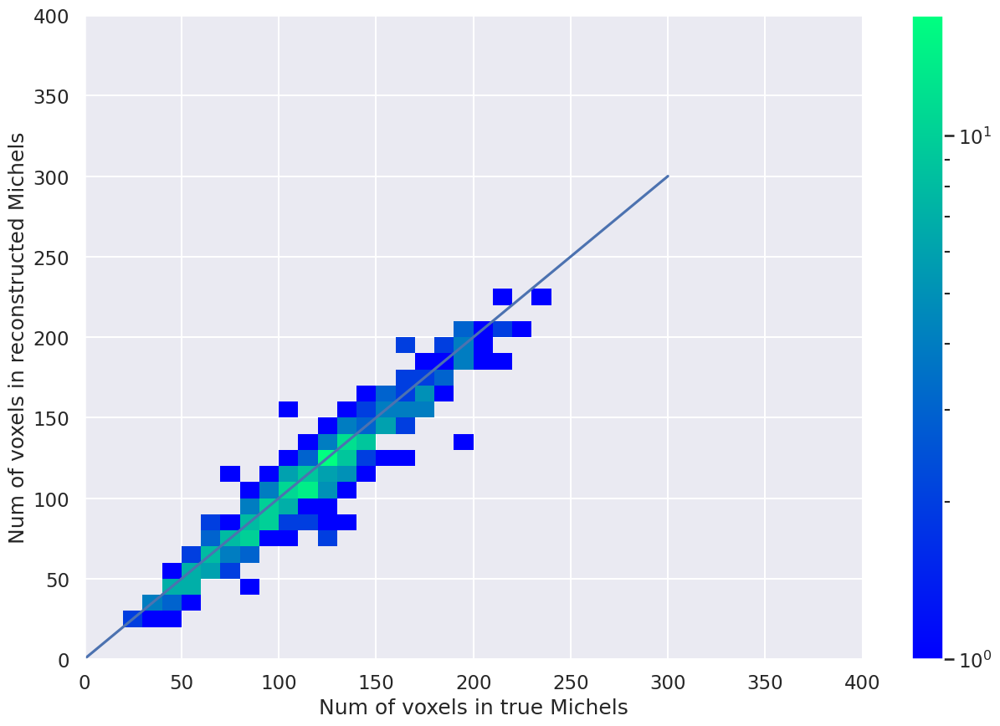

In [105]:
plt.hist2d(michels_hs_1['true_total_pix'],
          michels_hs_1['reco_total_pix'],
          bins=[40, 40], range=[[0, 400], [0, 400]], cmap='winter', norm=matplotlib.colors.LogNorm())
plt.colorbar()
xy = np.linspace(0,300,41)
plt.plot(xy, xy)
plt.xlabel('Num of voxels in true Michels')
plt.ylabel('Num of voxels in reconstructed Michels')
plt.show()

### Predicted vs. true primary voxel counts

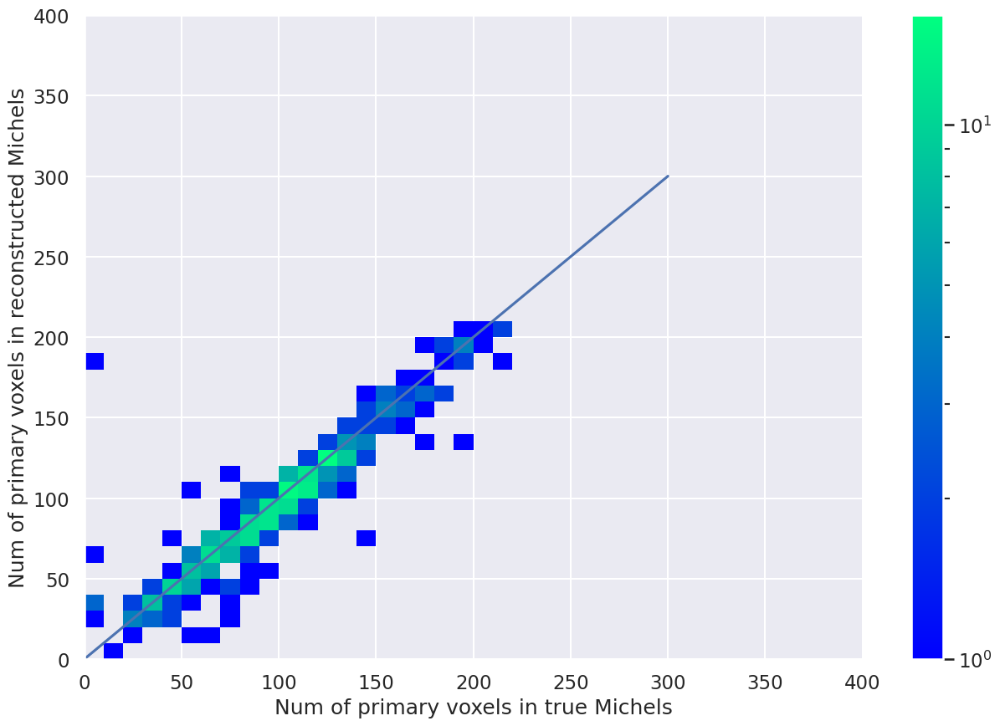

In [106]:
plt.hist2d(michels_hs_1['true_primary_pix'],
          michels_hs_1['reco_primary_pix'],
          bins=[40, 40], range=[[0, 400], [0, 400]], cmap='winter', norm=matplotlib.colors.LogNorm())
plt.colorbar()
xy = np.linspace(0,300,41)
plt.plot(xy, xy)
plt.xlabel('Num of primary voxels in true Michels')
plt.ylabel('Num of primary voxels in reconstructed Michels')
plt.show()

### Predicted vs. true total deposition

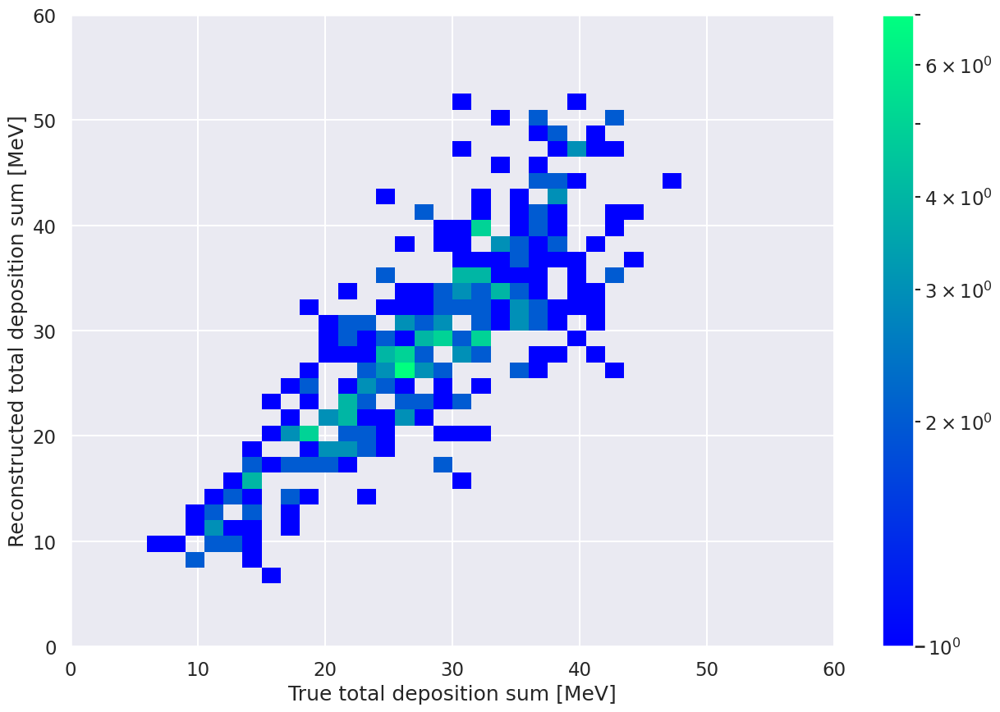

In [107]:
plt.hist2d(michels_hs_1['true_total_deposition'],
          michels_hs_1['reco_total_deposition'],
          bins=[40, 40], range=[[0, 60], [0, 60]], cmap='winter', norm=matplotlib.colors.LogNorm())
plt.colorbar()
#xy = np.linspace(0,300,41)
#plt.plot(xy, xy)
plt.xlabel('True total deposition sum [MeV]')
plt.ylabel('Reconstructed total deposition sum [MeV]')
plt.show()

### Predicted vs. true primary deposition

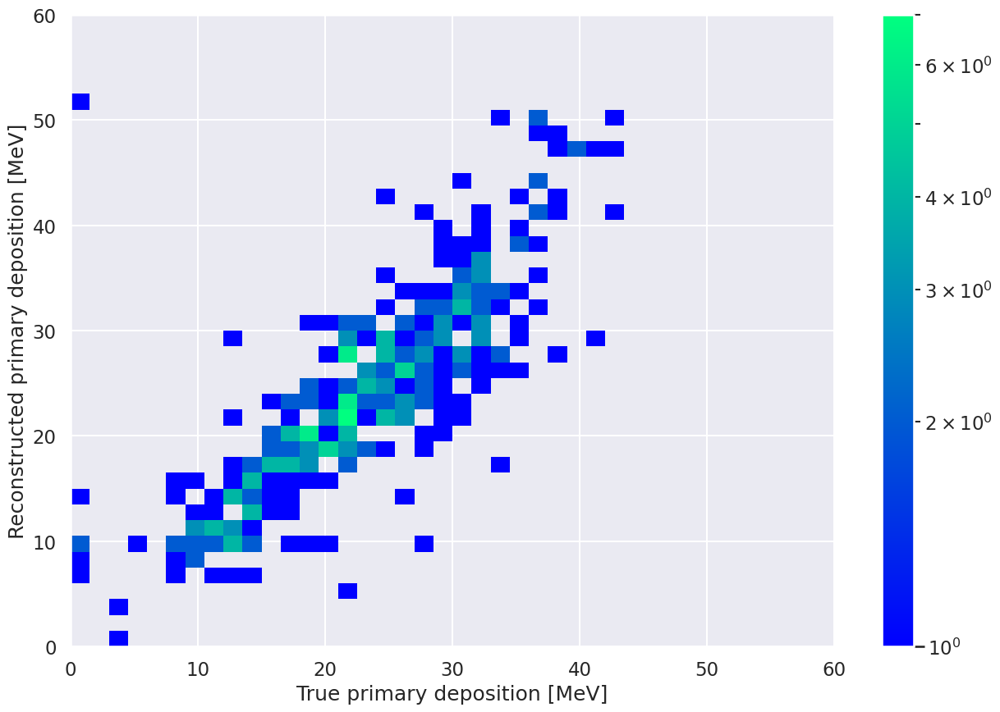

In [108]:
plt.hist2d(michels_hs_1['true_primary_deposition'],
          michels_hs_1['reco_primary_deposition'],
          bins=[40, 40], range=[[0, 60], [0, 60]], cmap='winter', norm=matplotlib.colors.LogNorm())
plt.colorbar()
#xy = np.linspace(0,300,41)
#plt.plot(xy, xy)
plt.xlabel('True primary deposition [MeV]')
plt.ylabel('Reconstructed primary deposition [MeV]')
plt.show()

## Exercises
1. Identify sources of inefficiency and inpurity\
Find which entries have true Michels that are not reconstructed\
Find which entries have reco. Michels that are not matched to a true Michel\
Visualize these entries in an event display\
Catalogue what is going wrong
3. Identify sources of recontruction error\
Visualize these entries in an event display\
Catalogue what is going wrong
4. Explore a different method to find the michels attached to a track (hint: look for attribute `end_point` from SPINE particle output)
5. Explore a different method to get the primary michel (hint: DBSCAN)
6. Estimate Michel energy resolution\
Draw the reco. particle charge depositions (particle.depositions.sum()) as a function of the match true particle kinetic energy (truth_particle.ke)\
Bin it in true KE, estimate the std in each bin
7. Change selection parameters
    (muon_min_voxel_count = 30,
    attach_threshold = 3,
    match_threshold = 0.5)
8. Performance as a function of energy
9. Find more variables to add to [michels] table
10. Apply shower fudge factor on reco deposition sum

In [39]:
michels_hs[michels_hs['true_total_pix']<0][:10]

,Unnamed: 0,index,id,attach_dist,is_attached,is_contained,is_matched,match_ids,match_overlaps,reco_primary_pix,reco_total_pix,reco_primary_deposition,reco_total_deposition,true_primary_pix,true_total_pix,true_primary_deposition,true_total_deposition,ke,true_ke
3,3,2,24,inf,False,False,True,[74],[0.2189781],30,30,8.229632,8.229632,-1,-1,-1.0,-1.0,10.171003,-1.0
7,7,4,12,inf,False,False,True,[81],[0.05882353],4,4,1.266695,1.266695,-1,-1,-1.0,-1.0,1.565508,-1.0
8,8,4,62,0.299988,True,False,True,[36],[0.3846154],26,26,6.192228,6.192228,-1,-1,-1.0,-1.0,7.652975,-1.0
12,12,6,36,inf,False,False,True,[50],[0.05882353],5,5,1.484287,1.484287,-1,-1,-1.0,-1.0,1.834430,-1.0
30,30,14,60,0.299988,True,True,True,[150],[0.04761905],38,43,12.490263,13.492626,-1,-1,-1.0,-1.0,16.675537,-1.0
37,37,16,43,0.299988,True,False,True,[14],[0.00119818],7,7,1.418232,1.418232,-1,-1,-1.0,-1.0,1.752793,-1.0
40,40,17,39,inf,False,True,True,[78],[0.00840336],1,1,0.357375,0.357375,-1,-1,-1.0,-1.0,0.441680,-1.0
49,49,19,158,0.299927,True,True,True,[74 36],[0.24698795 0.00034819],47,47,8.833788,8.833788,-1,-1,-1.0,-1.0,10.917679,-1.0
63,63,27,13,0.299988,True,False,True,[49],[0.18367347],10,10,1.841759,1.841759,-1,-1,-1.0,-1.0,2.276230,-1.0
71,71,29,97,0.299988,True,False,True,[35],[0.06666667],1,1,0.617805,0.617805,-1,-1,-1.0,-1.0,0.763546,-1.0


In [40]:
def filter_by_reco_interaction_id(data, reco_id=0, true_id=0):
    mask_reco = [abs(p.id - reco_id)<=1 for p in data["reco_particles"]]
    mask_true = [abs(p.id - true_id)<=1 for p in data["truth_particles"]]
    filtered = {}
    for key, value in data.items():
        if isinstance(value, list):
            if "reco" in key:
                filtered[key] = [v for v, keep in zip(value, mask_reco) if keep]
            elif "truth" in key:
                filtered[key] = [v for v, keep in zip(value, mask_true) if keep]
            else:
                filtered[key] = value
   
        else:
            filtered[key] = value
    return filtered

In [157]:
ENTRY = 12
data = driver.process(entry=ENTRY)
filtered_data = filter_by_reco_interaction_id(data, reco_id=53, true_id=118)
drawer = Drawer(data, detector='icarus', truth_point_mode='points') # Try to replace none with 'icarus', 'sbnd' or '2x2'!
drawer_filtered = Drawer(filtered_data, detector='icarus', truth_point_mode='points') # Try to replace none with 'icarus', 'sbnd' or '2x2'!

fig_filter = drawer_filtered.get('particles', 'shape', draw_end_points=False, draw_vertices=False) 
fig_filter.show()
fig = drawer.get('particles', 'shape', draw_end_points=False, draw_vertices=False) 
fig.show()